### Loading Packages and Data

In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
pd.set_option('display.max_rows', 8)

#import xarray as xr
import warnings
warnings.filterwarnings('ignore')
from matplotlib.backends.backend_pdf import PdfPages

from db_queries import get_outputs as go
from db_queries import get_ids
from get_draws.api import get_draws

In [2]:
ls /mnt/team/simulation_science/pub/models/vivarium_nih_us_cvd/results/vv-variable-coverage/alabama/2023_12_09_14_36_06/count_data

binned_ldl_exposure_time.csv     risk_exposure_time.csv
binned_ldl_exposure_time.hdf     risk_exposure_time.hdf
binned_sbp_exposure_time.csv     sbp_medication_person_time.csv
binned_sbp_exposure_time.hdf     sbp_medication_person_time.hdf
deaths.csv                       state_person_time.csv
deaths.hdf                       state_person_time.hdf
healthcare_visits.csv            transition_count.csv
healthcare_visits.hdf            transition_count.hdf
intervention_person_time.csv     ylds.csv
intervention_person_time.hdf     ylds.hdf
ldlc_medication_person_time.csv  ylls.csv
ldlc_medication_person_time.hdf  ylls.hdf


In [3]:
sim_results_dir = '/mnt/team/simulation_science/pub/models/vivarium_nih_us_cvd/results/vv-variable-coverage/alabama/2023_12_09_14_36_06/count_data'

## Checking Stability of Risks over Time

In [4]:
state_person_time = pd.read_csv(sim_results_dir + '/state_person_time.csv')
person_time = state_person_time.loc[state_person_time['state'].isin(["acute_ischemic_stroke", "chronic_ischemic_stroke", "susceptible_to_ischemic_stroke"])].reset_index() 
person_time = person_time.rename(columns = {'value':'ptvalue'})
per_time_group = person_time.groupby(['age', 'sex', 'year','input_draw','scenario','location']).ptvalue.sum().reset_index()
per_time_group.head()

,age,sex,year,input_draw,scenario,location,ptvalue
0,25_to_29,Female,2021,29,baseline,alabama,1957.355236
1,25_to_29,Female,2021,29,baseline,california,2112.591376
2,25_to_29,Female,2021,29,baseline,florida,1824.887064
3,25_to_29,Female,2021,29,baseline,new_mexico,1847.808350
4,25_to_29,Female,2021,29,baseline,new_york,2067.438741


# SBP Medications

In [5]:
meds = pd.read_csv(sim_results_dir + '/sbp_medication_person_time.csv')
meds.head()

,Unnamed: 0,sex,year,measure,input_draw,scenario,location,age,medication_adherence,sbp_medication,value
0,0,Female,2021,sbp_medication_person_time,29,baseline,alabama,25_to_29,primary_non_adherent,no_treatment,299.126626
1,1,Female,2021,sbp_medication_person_time,29,baseline,california,25_to_29,primary_non_adherent,no_treatment,292.610541
2,2,Female,2021,sbp_medication_person_time,29,baseline,florida,25_to_29,primary_non_adherent,no_treatment,260.873374
3,3,Female,2021,sbp_medication_person_time,29,baseline,new_mexico,25_to_29,primary_non_adherent,no_treatment,286.477755
4,4,Female,2021,sbp_medication_person_time,29,baseline,new_york,25_to_29,primary_non_adherent,no_treatment,302.959617


In [17]:
meds_adherent = meds.groupby(['sex', 'year', 'input_draw', 'age', 'sbp_medication','scenario', 'location']).value.sum().reset_index()
meds_adherent_rate = meds_adherent.merge(per_time_group[['ptvalue','sex','age','year','input_draw','scenario','location']], on=['sex','age','year','input_draw','scenario','location'])
meds_adherent_rate['meds_adherent_rate'] = meds_adherent_rate['value'] / meds_adherent_rate['ptvalue']
meds_adherent_rate_summ = (meds_adherent_rate
                .groupby(['sex', 'year', 'sbp_medication','age','location'])
                .meds_adherent_rate.describe(percentiles=[.025, .975])
                .filter(['mean', '2.5%', '97.5%'])
                .reset_index())
meds_adherent_rate_summ

,sex,year,sbp_medication,age,location,mean,2.5%,97.5%
0,Female,2021,no_treatment,25_to_29,alabama,0.925635,0.914552,0.935883
1,Female,2021,no_treatment,25_to_29,california,0.924545,0.918444,0.937381
2,Female,2021,no_treatment,25_to_29,florida,0.885926,0.872226,0.899524
3,Female,2021,no_treatment,25_to_29,new_mexico,0.976654,0.973646,0.979639
...,...,...,...,...,...,...,...,...
41996,Male,2040,two_drug_std_dose_efficacy,95_plus,pennsylvania,0.023185,0.000000,0.068529
41997,Male,2040,two_drug_std_dose_efficacy,95_plus,texas,0.036955,0.000000,0.091993
41998,Male,2040,two_drug_std_dose_efficacy,95_plus,washington,0.041860,0.016081,0.075982
41999,Male,2040,two_drug_std_dose_efficacy,95_plus,west_virginia,0.031151,0.001775,0.062210


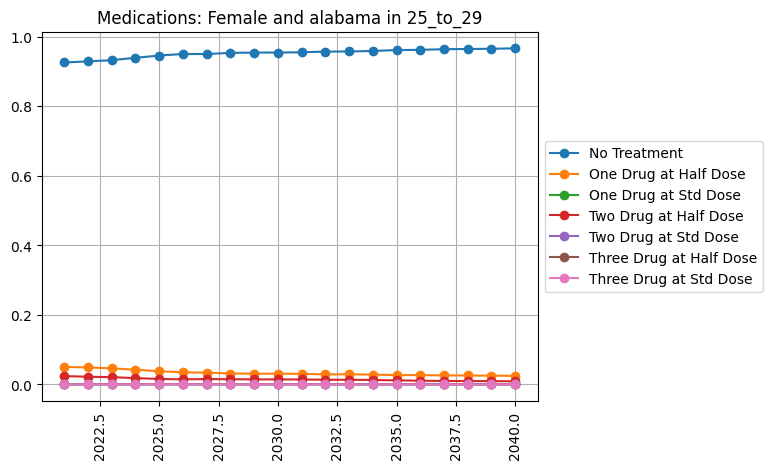

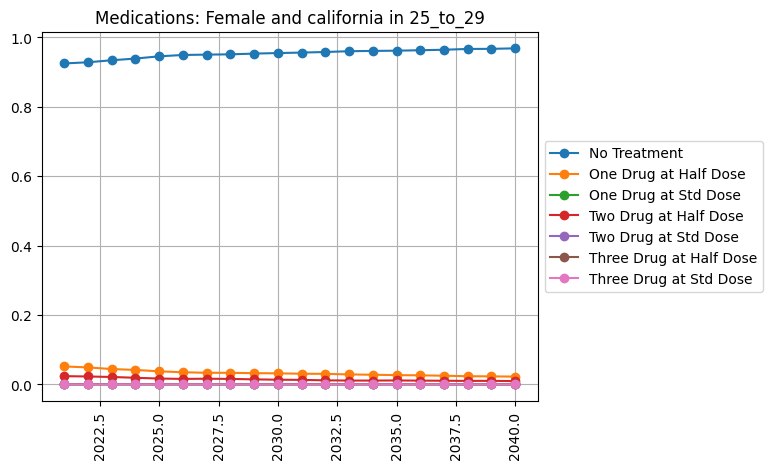

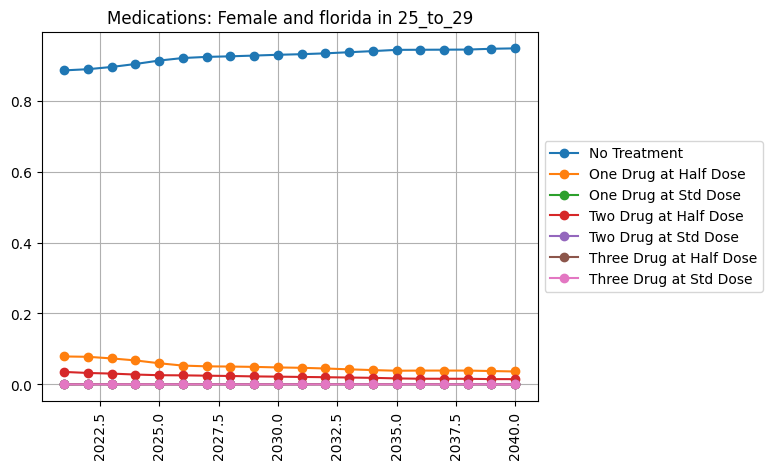

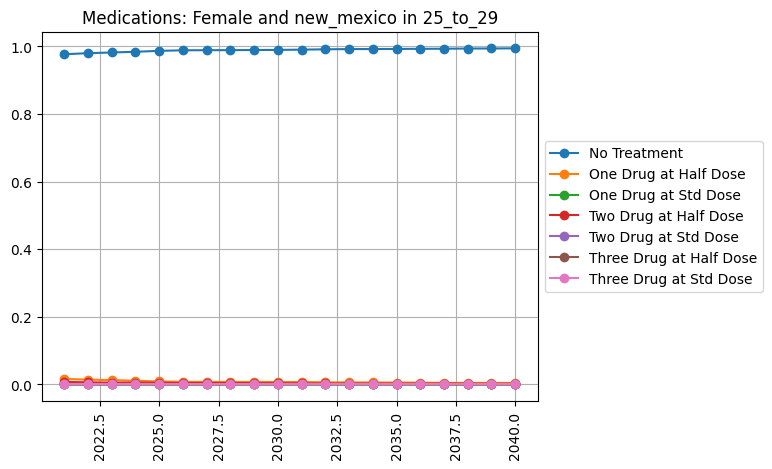

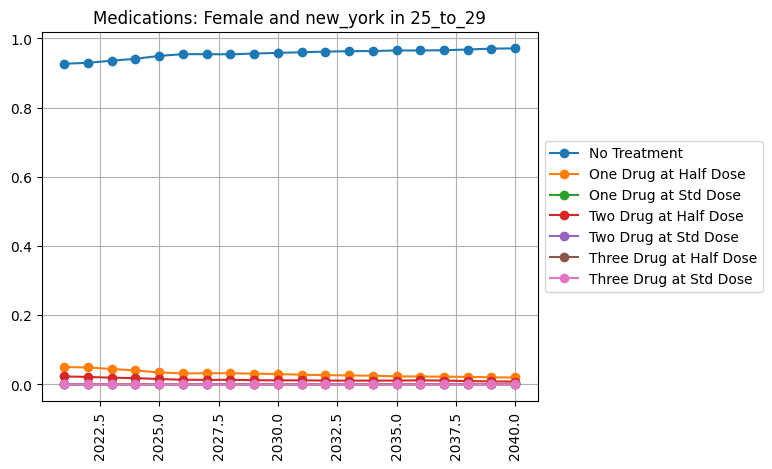

...

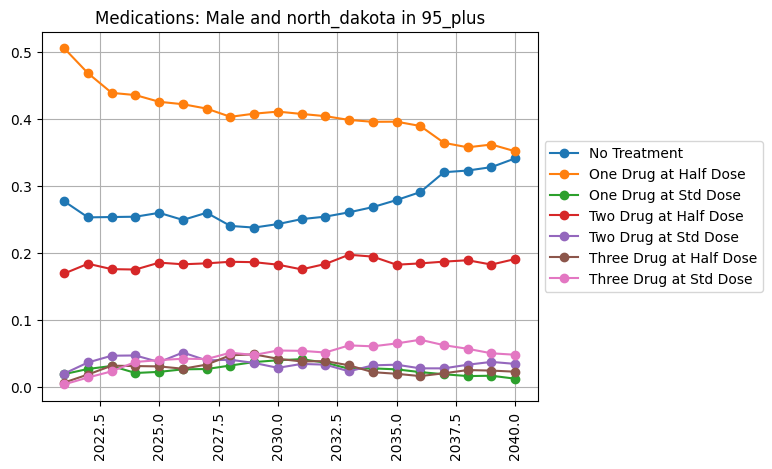

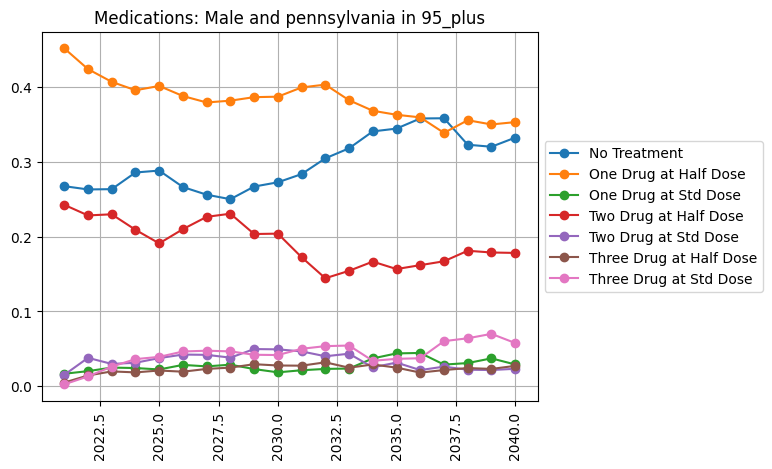

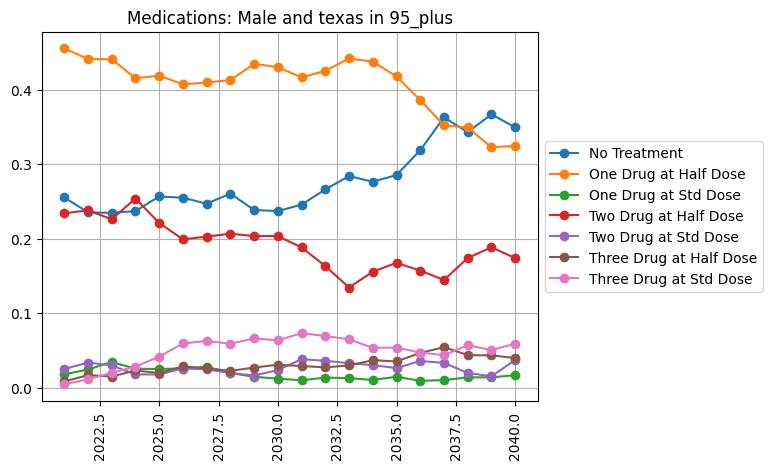

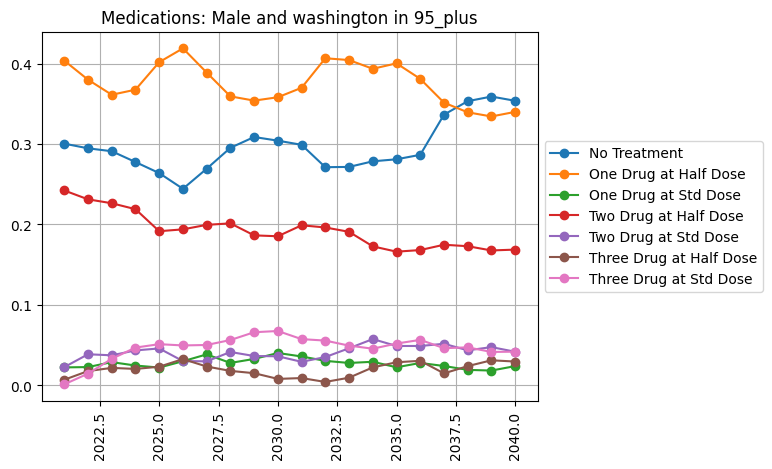

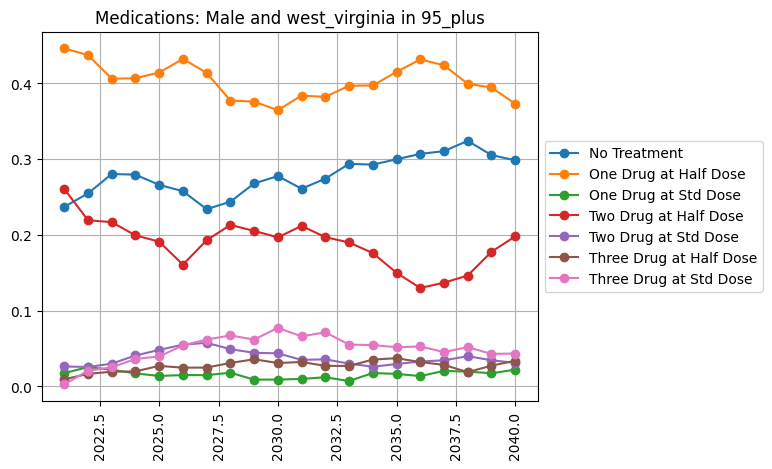

In [18]:
#%%capture
for age in meds_adherent_rate_summ.age.unique():
    for sex in meds_adherent_rate_summ.sex.unique():
        for location in meds_adherent_rate_summ.location.unique(): 
            plt.figure() 
            no_trt = meds_adherent_rate_summ.loc[(meds_adherent_rate_summ.location==location) & (meds_adherent_rate_summ.sex==sex) & (meds_adherent_rate_summ.age==age) & (meds_adherent_rate_summ.sbp_medication=='no_treatment')]
            plt.plot(no_trt['year'], no_trt['mean'], marker='o')
            #plt.fill_between(no_trt['year'], no_trt['2.5%'], no_trt['97.5%'], alpha=.3)
            one_half = meds_adherent_rate_summ.loc[(meds_adherent_rate_summ.location==location) & (meds_adherent_rate_summ.sex==sex) & (meds_adherent_rate_summ.age==age) & (meds_adherent_rate_summ.sbp_medication=='one_drug_half_dose_efficacy')]
            plt.plot(one_half['year'], one_half['mean'], marker='o')
            #plt.fill_between(one_half['year'], one_half['2.5%'], one_half['97.5%'], alpha=.3)
            one_std = meds_adherent_rate_summ.loc[(meds_adherent_rate_summ.location==location) & (meds_adherent_rate_summ.sex==sex) & (meds_adherent_rate_summ.age==age) & (meds_adherent_rate_summ.sbp_medication=='one_drug_std_dose_efficacy')]
            plt.plot(one_std['year'], one_std['mean'], marker='o')
            #plt.fill_between(one_std['year'], one_std['2.5%'], one_std['97.5%'], alpha=.3)
            two_half = meds_adherent_rate_summ.loc[(meds_adherent_rate_summ.location==location) & (meds_adherent_rate_summ.sex==sex) & (meds_adherent_rate_summ.age==age) & (meds_adherent_rate_summ.sbp_medication=='two_drug_half_dose_efficacy')]
            plt.plot(two_half['year'], two_half['mean'], marker='o')
            #plt.fill_between(two_half['year'], two_half['2.5%'], two_half['97.5%'], alpha=.3)
            two_std = meds_adherent_rate_summ.loc[(meds_adherent_rate_summ.location==location) & (meds_adherent_rate_summ.sex==sex) & (meds_adherent_rate_summ.age==age) & (meds_adherent_rate_summ.sbp_medication=='two_drug_std_dose_efficacy')]
            plt.plot(two_std['year'], two_std['mean'], marker='o')
            #plt.fill_between(two_std['year'], two_std['2.5%'], two_std['97.5%'], alpha=.3)
            three_half = meds_adherent_rate_summ.loc[(meds_adherent_rate_summ.location==location) & (meds_adherent_rate_summ.sex==sex) & (meds_adherent_rate_summ.age==age) & (meds_adherent_rate_summ.sbp_medication=='three_drug_half_dose_efficacy')]
            plt.plot(three_half['year'], three_half['mean'], marker='o')
            #plt.fill_between(three_half['year'], three_half['2.5%'], three_half['97.5%'], alpha=.3)
            three_std = meds_adherent_rate_summ.loc[(meds_adherent_rate_summ.location==location) & (meds_adherent_rate_summ.sex==sex) & (meds_adherent_rate_summ.age==age) & (meds_adherent_rate_summ.sbp_medication=='three_drug_std_dose_efficacy')]
            plt.plot(three_std['year'], three_std['mean'], marker='o')
            #plt.fill_between(three_std['year'], three_std['2.5%'], three_std['97.5%'], alpha=.3)
            plt.title(f'Medications: {sex} and {location} in {age}') 
            plt.xticks(rotation=90)
            plt.legend(['No Treatment', 'One Drug at Half Dose','One Drug at Std Dose','Two Drug at Half Dose','Two Drug at Std Dose','Three Drug at Half Dose','Three Drug at Std Dose'],loc='center left', bbox_to_anchor=(1, 0.5))
            plt.grid()

In [19]:
ldl_meds = pd.read_csv(sim_results_dir + '/ldlc_medication_person_time.csv')
ldl_meds.head()

,Unnamed: 0,sex,year,measure,input_draw,scenario,location,age,medication_adherence,ldlc_medication,value
0,0,Female,2021,ldlc_medication_person_time,29,baseline,alabama,25_to_29,primary_non_adherent,high_intensity,0.0
1,1,Female,2021,ldlc_medication_person_time,29,baseline,california,25_to_29,primary_non_adherent,high_intensity,0.0
2,2,Female,2021,ldlc_medication_person_time,29,baseline,florida,25_to_29,primary_non_adherent,high_intensity,0.0
3,3,Female,2021,ldlc_medication_person_time,29,baseline,new_mexico,25_to_29,primary_non_adherent,high_intensity,0.0
4,4,Female,2021,ldlc_medication_person_time,29,baseline,new_york,25_to_29,primary_non_adherent,high_intensity,0.0


In [21]:
meds_adherent = ldl_meds.groupby(['sex', 'year', 'input_draw', 'age', 'ldlc_medication','scenario', 'location']).value.sum().reset_index()
meds_adherent_rate = meds_adherent.merge(per_time_group[['ptvalue','sex','age','year','input_draw','scenario','location']], on=['sex','age','year','input_draw','scenario','location'])
meds_adherent_rate['meds_adherent_rate'] = meds_adherent_rate['value'] / meds_adherent_rate['ptvalue']
meds_adherent_rate_summ = (meds_adherent_rate
                .groupby(['sex', 'year', 'ldlc_medication','age','location'])
                .meds_adherent_rate.describe(percentiles=[.025, .975])
                .filter(['mean', '2.5%', '97.5%'])
                .reset_index())
meds_adherent_rate_summ

,sex,year,ldlc_medication,age,location,mean,2.5%,97.5%
0,Female,2021,high_intensity,25_to_29,alabama,0.003554,0.002006,0.005449
1,Female,2021,high_intensity,25_to_29,california,0.009864,0.006313,0.011615
2,Female,2021,high_intensity,25_to_29,florida,0.010511,0.005964,0.014169
3,Female,2021,high_intensity,25_to_29,new_mexico,0.001813,0.000669,0.005344
...,...,...,...,...,...,...,...,...
35996,Male,2040,no_treatment,95_plus,pennsylvania,0.492423,0.398150,0.592052
35997,Male,2040,no_treatment,95_plus,texas,0.456347,0.323392,0.564749
35998,Male,2040,no_treatment,95_plus,washington,0.492953,0.387845,0.589254
35999,Male,2040,no_treatment,95_plus,west_virginia,0.445375,0.362566,0.537699


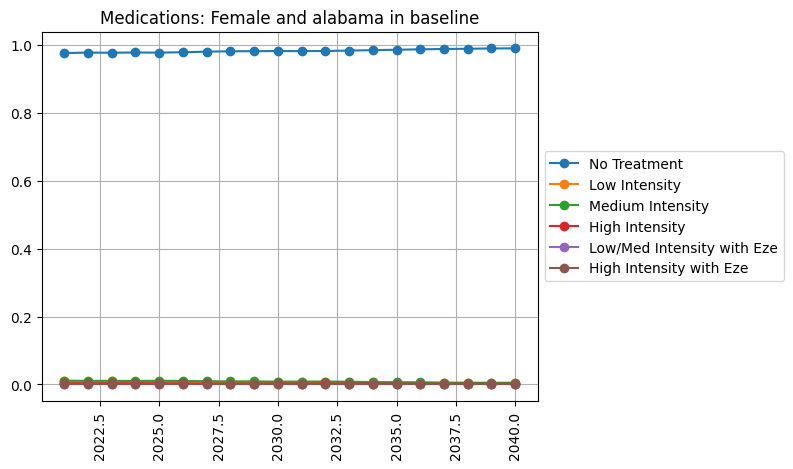

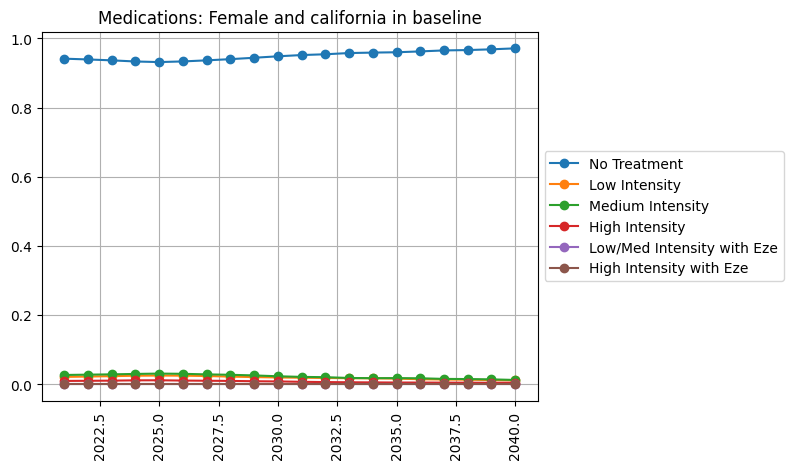

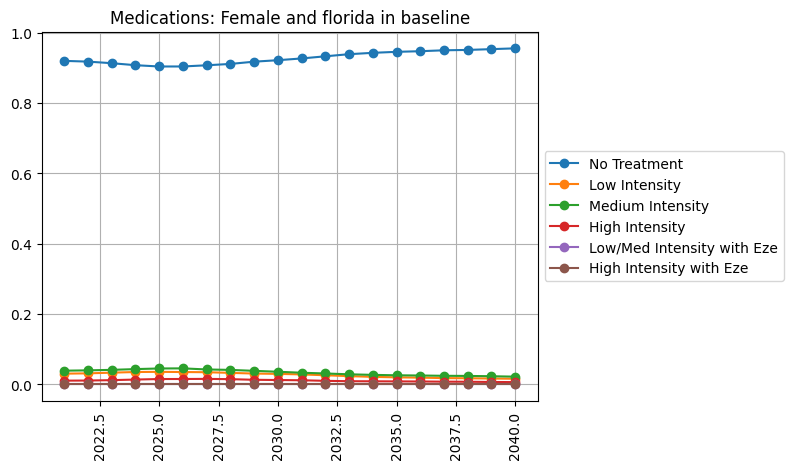

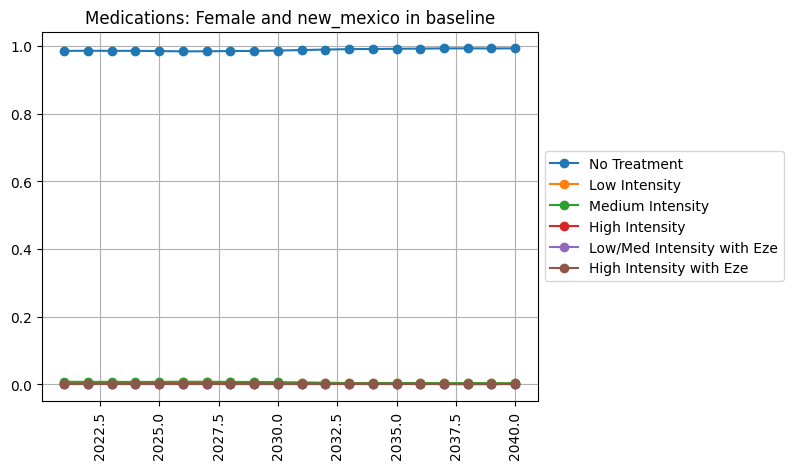

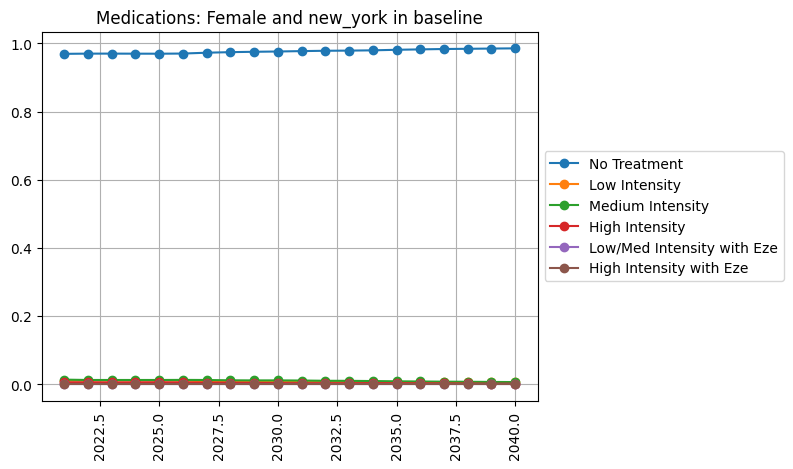

...

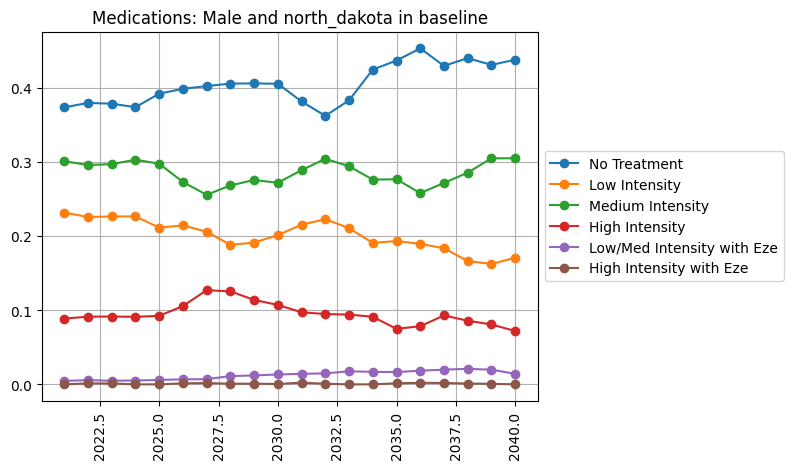

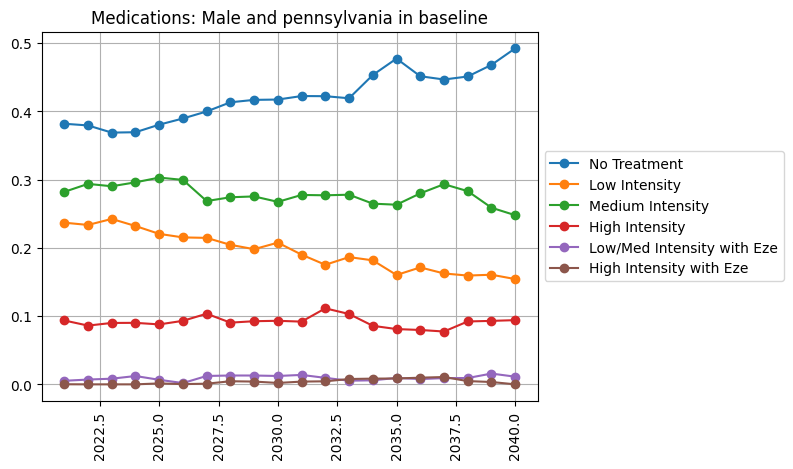

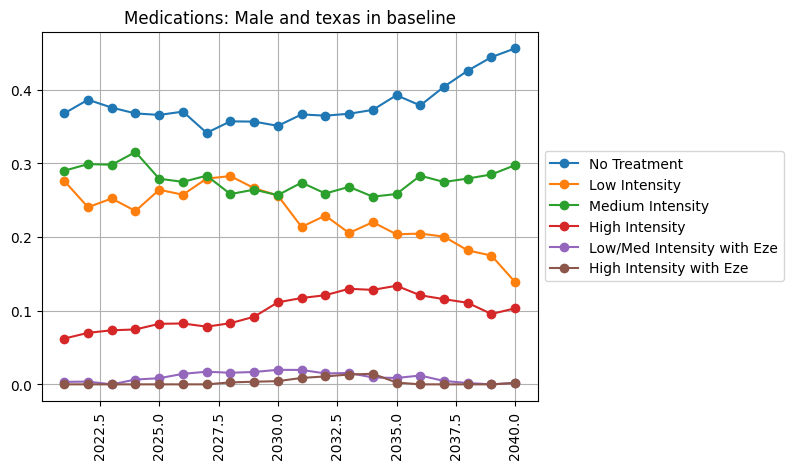

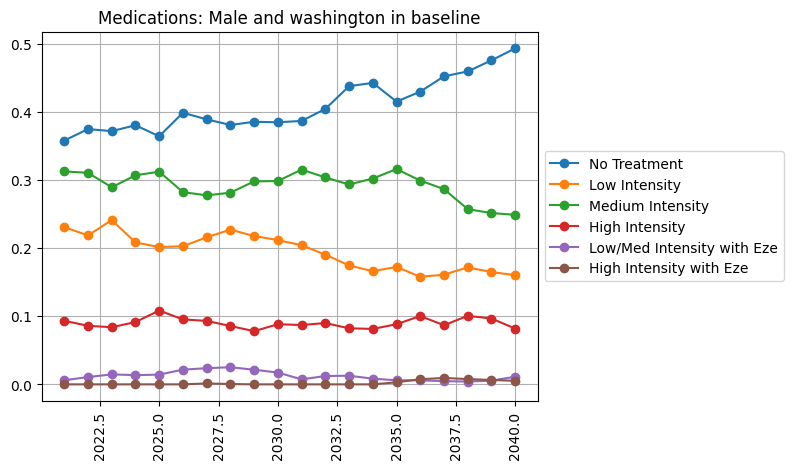

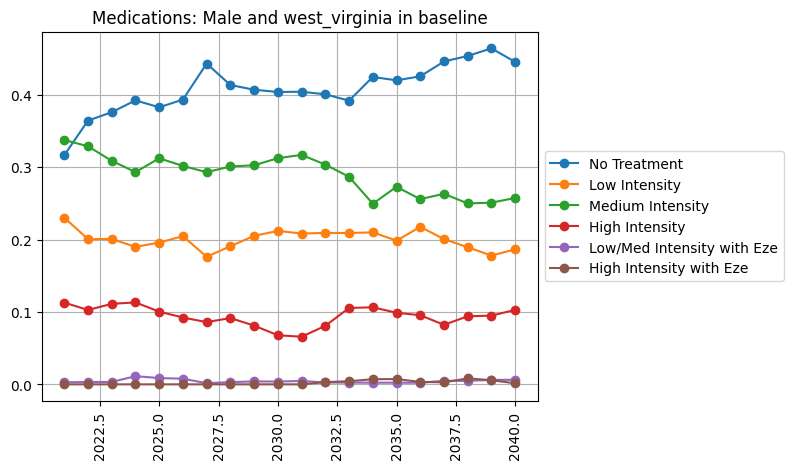

In [22]:
#%%capture
for age in meds_adherent_rate_summ.age.unique():
    for sex in meds_adherent_rate_summ.sex.unique():
        for location in meds_adherent_rate_summ.location.unique():
            plt.figure() 
            no_trt = meds_adherent_rate_summ.loc[(meds_adherent_rate_summ.location==location) & (meds_adherent_rate_summ.sex==sex) & (meds_adherent_rate_summ.age==age) & (meds_adherent_rate_summ.ldlc_medication=='no_treatment')]
            plt.plot(no_trt['year'], no_trt['mean'], marker='o')
            #plt.fill_between(no_trt['year'], no_trt['2.5%'], no_trt['97.5%'], alpha=.3)
            one_half = meds_adherent_rate_summ.loc[(meds_adherent_rate_summ.location==location) & (meds_adherent_rate_summ.sex==sex) & (meds_adherent_rate_summ.age==age) & (meds_adherent_rate_summ.ldlc_medication=='low_intensity')]
            plt.plot(one_half['year'], one_half['mean'], marker='o')
            #plt.fill_between(one_half['year'], one_half['2.5%'], one_half['97.5%'], alpha=.3)
            one_std = meds_adherent_rate_summ.loc[(meds_adherent_rate_summ.location==location) & (meds_adherent_rate_summ.sex==sex) & (meds_adherent_rate_summ.age==age) & (meds_adherent_rate_summ.ldlc_medication=='medium_intensity')]
            plt.plot(one_std['year'], one_std['mean'], marker='o')
            #plt.fill_between(one_std['year'], one_std['2.5%'], one_std['97.5%'], alpha=.3)
            two_half = meds_adherent_rate_summ.loc[(meds_adherent_rate_summ.location==location) & (meds_adherent_rate_summ.sex==sex) & (meds_adherent_rate_summ.age==age) & (meds_adherent_rate_summ.ldlc_medication=='high_intensity')]
            plt.plot(two_half['year'], two_half['mean'], marker='o')
            #plt.fill_between(two_half['year'], two_half['2.5%'], two_half['97.5%'], alpha=.3)
            two_std = meds_adherent_rate_summ.loc[(meds_adherent_rate_summ.location==location) & (meds_adherent_rate_summ.sex==sex) & (meds_adherent_rate_summ.age==age) & (meds_adherent_rate_summ.ldlc_medication=='low_med_with_eze')]
            plt.plot(two_std['year'], two_std['mean'], marker='o')
            #plt.fill_between(two_std['year'], two_std['2.5%'], two_std['97.5%'], alpha=.3)
            three_half = meds_adherent_rate_summ.loc[(meds_adherent_rate_summ.location==location) & (meds_adherent_rate_summ.sex==sex) & (meds_adherent_rate_summ.age==age) & (meds_adherent_rate_summ.ldlc_medication=='high_with_eze')]
            plt.plot(three_half['year'], three_half['mean'], marker='o')
            #plt.fill_between(three_half['year'], three_half['2.5%'], three_half['97.5%'], alpha=.3)
            plt.title(f'Medications: {sex} and {location} in {scenario}') 
            plt.xticks(rotation=90)
            plt.legend(['No Treatment','Low Intensity','Medium Intensity','High Intensity','Low/Med Intensity with Eze','High Intensity with Eze'],loc='center left', bbox_to_anchor=(1, 0.5))
            plt.grid()